## Imports

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import calplot
import numpy as np
import plotly.express as px
from urllib.request import urlopen
import json
import warnings
import folium
from IPython.display import display, HTML
from folium import plugins
from folium.plugins import HeatMap

## Handle warnings

In [2]:
# Ignore warnings for readability
warnings.filterwarnings('ignore')

## Load data
## ! Path variable would need to be changed to fit !

In [3]:
PATH_VARIABLE = "../data/Police_Incident_Reports_2003_to_2018.csv"
#PATH_VARIABLE = "../lectures/Police_Reports_2018.csv"

In [4]:
df = pd.read_csv(PATH_VARIABLE) 
df.head()

,PdId,IncidntNum,Incident Code,Category,Descript,DayOfWeek,Date,Time,PdDistrict,Resolution,...,Fix It Zones as of 2017-11-06 2 2,DELETE - HSOC Zones 2 2,Fix It Zones as of 2018-02-07 2 2,"CBD, BID and GBD Boundaries as of 2017 2 2","Areas of Vulnerability, 2016 2 2",Central Market/Tenderloin Boundary 2 2,Central Market/Tenderloin Boundary Polygon - Updated 2 2,HSOC Zones as of 2018-06-05 2 2,OWED Public Spaces 2 2,Neighborhoods 2
0,4133422003074,41334220,3074,ROBBERY,"ROBBERY, BODILY FORCE",Monday,11/22/2004,17:50,INGLESIDE,NONE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,5118535807021,51185358,7021,VEHICLE THEFT,STOLEN AUTOMOBILE,Tuesday,10/18/2005,20:00,PARK,NONE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,4018830907021,40188309,7021,VEHICLE THEFT,STOLEN AUTOMOBILE,Sunday,02/15/2004,02:00,SOUTHERN,NONE,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,11014543126030,110145431,26030,ARSON,ARSON,Friday,02/18/2011,05:27,INGLESIDE,NONE,...,NaN,NaN,NaN,NaN,1.0,NaN,NaN,NaN,NaN,94.0
4,10108108004134,101081080,4134,ASSAULT,BATTERY,Sunday,11/21/2010,17:00,SOUTHERN,NONE,...,NaN,NaN,NaN,NaN,2.0,NaN,NaN,NaN,NaN,32.0


## A1 Part 1

> * Create **weekly patterns** as barcharts
> * Create **monthly patterns** as barcharts
> * Create **24 hours cycle** as barcharts
> * Create **168 hours cycle** as barcharts
>
> * Create a **calendar plot** for a chosen crime type 
> * Create **polar bar char** for a diffrent chosen crime type and its 24 cycle
>
> For all the above: Always describe the set of plots, and pick a few aspects that stand out to you and comment on those.
>
> * Write a short reflection on how you've used LLMs to solve these assignments

### Preparation 

In [5]:
# Include relevant date range only (2003 to 2017)
df['Date'] = pd.to_datetime(df['Date']) 
filtered_df = df.loc[(df['Date'] >= '01/01/2003') & (df['Date'] <= '12/31/2017')]

# Filter categories to only include focus crimes
focuscrimes = sorted(['WEAPON LAWS', 'PROSTITUTION', 'DRIVING UNDER THE INFLUENCE', 'ROBBERY', 'BURGLARY', 'ASSAULT', 'DRUNKENNESS', 'DRUG/NARCOTIC', 'TRESPASS', 'LARCENY/THEFT', 'VANDALISM', 'VEHICLE THEFT', 'STOLEN PROPERTY', 'DISORDERLY CONDUCT'])
filtered_df = filtered_df[filtered_df['Category'].isin(focuscrimes)]
focuscrimes_df = filtered_df[filtered_df['Category'].isin(focuscrimes)]

In [6]:
# Function to plot the different patterns
def plot_crimes(crimes, xlabel, ylabel, title, show_xticks=True):
    fig, axes = plt.subplots(nrows=len(focuscrimes) // 2 , ncols=2, figsize=(14, 30))
    for i, (category, ax) in enumerate(zip(crimes.columns, axes.flatten()), 1):
        crimes[category].plot(kind='bar', ax=ax, color='skyblue')
        ax.set_title(category) 
        ax.set_xlabel(xlabel)
        ax.set_ylabel(ylabel)
        if not show_xticks:
            ax.set_xticks([])  
        else:
            ax.set_xticklabels(crimes.index, rotation=45) 

    plt.suptitle(title, fontsize=16)
    plt.tight_layout(rect=[0, 0.03, 1, 0.95])  
    plt.subplots_adjust(wspace=0.2)
    plt.show()

### * Weekly pattern

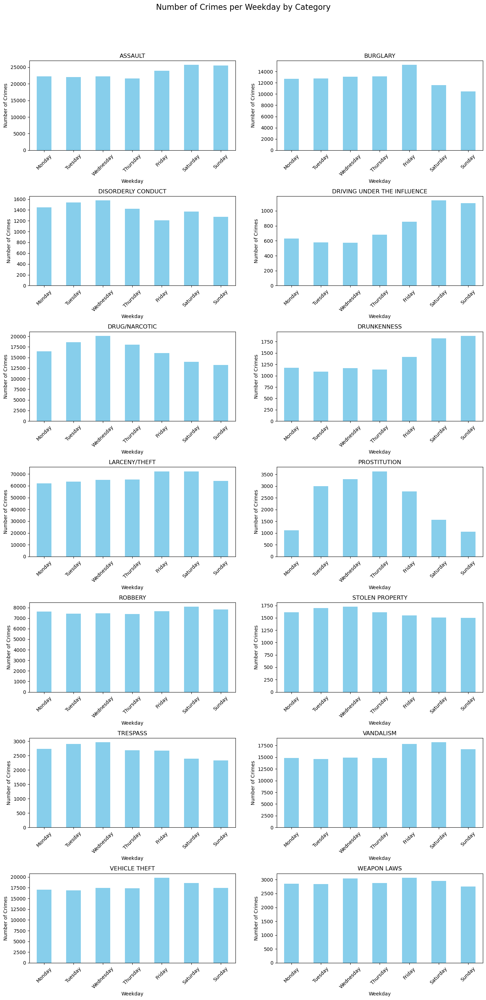

In [7]:
# Calculate number of crimes for each category, grouped by day of the week
crimes_per_day_df = filtered_df.groupby(['DayOfWeek', 'Category']).size().unstack(fill_value=0) 

# Order weekdays for the plot
crimes_per_day_df = crimes_per_day_df.reindex(['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], axis=0) 

# Plot data
plot_crimes(crimes_per_day_df, 'Weekday', 'Number of Crimes', 'Number of Crimes per Weekday by Category') 

**Description**: The number of crimes per weekday reveal some patterns. It's surprising that there are more cases of prostitution and drug/narcotic crimes in the middle of the week. On the other hand, it makes sense that there are more cases of drunkenness and driving under the influence on weekends. One reason for this could be that people go out more on weekends and party, leading to more alcohol-related crimes. 

### * Monthly pattern

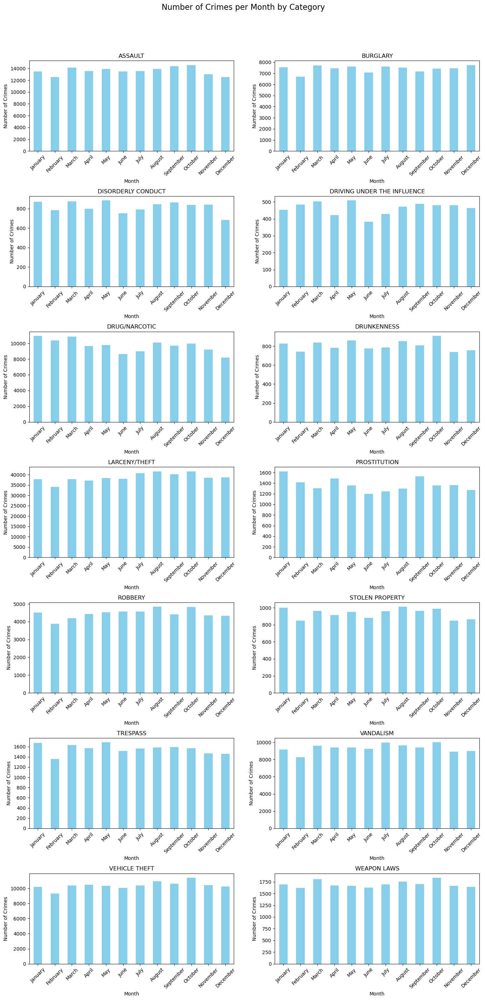

In [8]:
# Calculate number of crimes for each category, grouped by (ordered) month
filtered_df.loc[:, 'Month'] = pd.Categorical(filtered_df['Date'].dt.month_name(), 
                                             categories=['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'], 
                                             ordered=True)

crimes_by_month_df = filtered_df.groupby(['Month', 'Category']).size().unstack(fill_value=0)

# Plot data
plot_crimes(crimes_by_month_df, 'Month', 'Number of Crimes', 'Number of Crimes per Month by Category')

**Description**: The monthly pattern shows us how many crimes happen each month. It's interesting because most crimes stay pretty steady, like theft and assault, but we notice a drop in prostitution, driving under the influence, and drug/narcotic crimes during the summer months, especially in June and July. 

### * 24 Hour Cycle

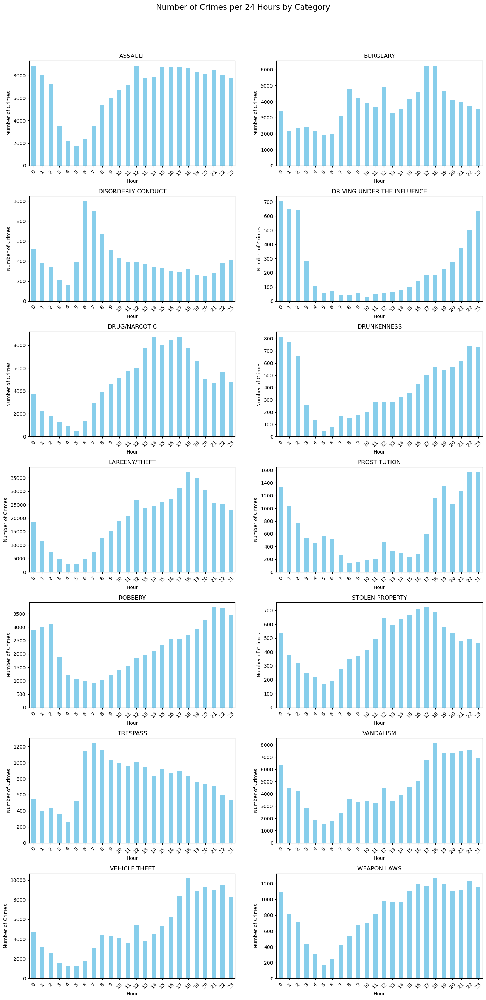

In [9]:
# Calculate number of crimes for each category, grouped by hours
filtered_df.loc[:, 'Hour'] = pd.to_datetime(filtered_df['Time'], format='%H:%M').dt.hour
crimes_by_hour_df = filtered_df.groupby(['Hour', 'Category']).size().unstack(fill_value=0)

# Plot data
plot_crimes(crimes_by_hour_df, 'Hour', 'Number of Crimes', 'Number of Crimes per 24 Hours by Category')

**Description**: Analyzing crime trends throughout the day reveals interesting patterns. Vehicle theft and vandalism peak in the evening, likely due to reduced visibility. Disorderly conduct surprisingly peaks in the early morning, possibly the aftermath of late-night activities. Drug-related incidents surprisingly rise before evening hours. Reasons might be that daytime hours may provide more opportunities for drug transactions or people might buy more drugs during the day to have them for the evening. While drunk driving and drunkness peaks at night, possibly reflecting post-work social outings and leisure activities. 

### * Hours of the week

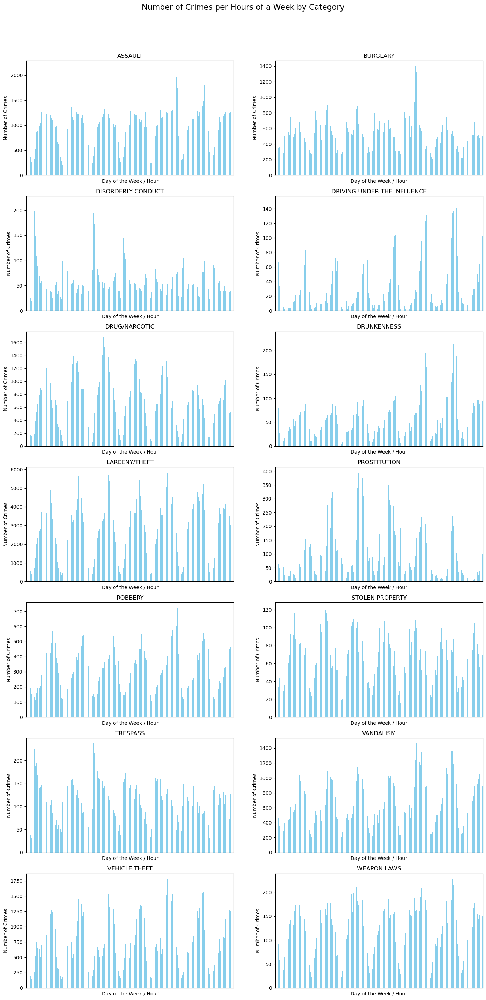

In [10]:
# Calculate number of crimes for each category, grouped by hours and weekday
filtered_df.loc[:, 'Hour'] = pd.to_datetime(filtered_df['Time'], format='%H:%M').dt.hour
filtered_df.loc[:, 'Weekday'] = pd.Categorical(filtered_df['DayOfWeek'],
                                           categories=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
                                           ordered=True)

crimes_by_day_hour_df = filtered_df.groupby(['Weekday', 'Hour', 'Category']).size().unstack(fill_value=0)

# Plot data
plot_crimes(crimes_by_day_hour_df, 'Day of the Week / Hour', 'Number of Crimes', 'Number of Crimes per Hours of a Week by Category', False)

**Description**: Looking at crime trends throughout the hours of the entire week gives us some new inights. Assault peaks on Friday and Saturday nights, coinciding with an increase in drunkness. Driving under the influence occurs later in the night across all weekdays, reflecting driving after evening drinking, which is also higher in the evening. Trespassing and disorderly conduct peak on Monday, Tuesdays and Wednesdays.

### * Calendar plot for vehicle theft

In [11]:
# Function to create a calendar plot
def create_calendar_plot(data_series, title):
    plt.figure(figsize=(14, 8))
    calplot.calplot(data_series, cmap='YlGn', colorbar=True, suptitle=title, tight_layout=True)
    plt.show()

findfont: Font family ['Helvetica'] not found. Falling back to DejaVu Sans.


<Figure size 1400x800 with 0 Axes>

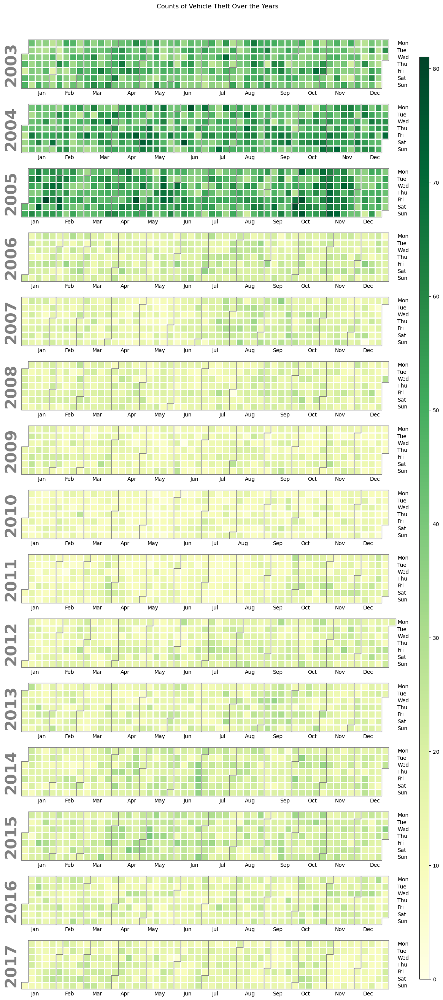

In [12]:
category = "VEHICLE THEFT"

# Calculate number of vehicle theft cases, grouped by year and date
vehicle_theft_df = filtered_df[filtered_df['Category'] == category]
vehicle_theft_df.loc[:,'Year'] = vehicle_theft_df['Date'].dt.year
vehicle_theft_counts = vehicle_theft_df.groupby(['Year', 'Date']).size().unstack(fill_value=0)

# Plot data
data_series = pd.Series(vehicle_theft_counts.sum(axis=0), index=pd.to_datetime(vehicle_theft_counts.columns)) 
create_calendar_plot(data_series, 'Counts of Vehicle Theft Over the Years')

**Description**: The calendar plot shows the number of vehicle theft incidents in San Francisco over the years. There is a big drop in vehicle thefts after 2005. This decline might be linked with the introduction and widespread adoption of 'engine immobilizer systems, mentioned in lecture 1, which make it hard for thieves to start a car without the right key.

### * Polar bar chart for stolen property and its 24 hour cylce

In [13]:
# Function to create a polar bar chart
def create_polar_bar_chart(counts, category):
    plt.figure(figsize=(20,10))
    ax = plt.subplot(111, polar=True)
    plt.axis('off')

    angles = np.linspace(0, 2 * np.pi, len(counts.index), endpoint=False) + np.pi / 24
    heights = counts.values
    width = np.pi / 12  
    lowerLimit = 0

    bars = ax.bar(
        x=angles, 
        height=heights, 
        width=width, 
        bottom=lowerLimit,
        linewidth=2, 
        edgecolor="white",
        color="orange",
    )

    labelPadding = 8

    for bar, angle, height, label in zip(bars, angles, heights, counts.index):
        rotation = np.rad2deg(angle)

        alignment = ""
        if angle >= np.pi/2 and angle < 3*np.pi/2:
            alignment = "right"
            rotation = rotation + 180
        else: 
            alignment = "left"

        ax.text(
            x=angle, 
            y=lowerLimit + bar.get_height() + labelPadding, 
            s=str(label), 
            ha=alignment, 
            va='center', 
            rotation=rotation, 
            rotation_mode="anchor")

    plt.title(f'{category} cases during a day (24 hour cycle)')
    plt.show()

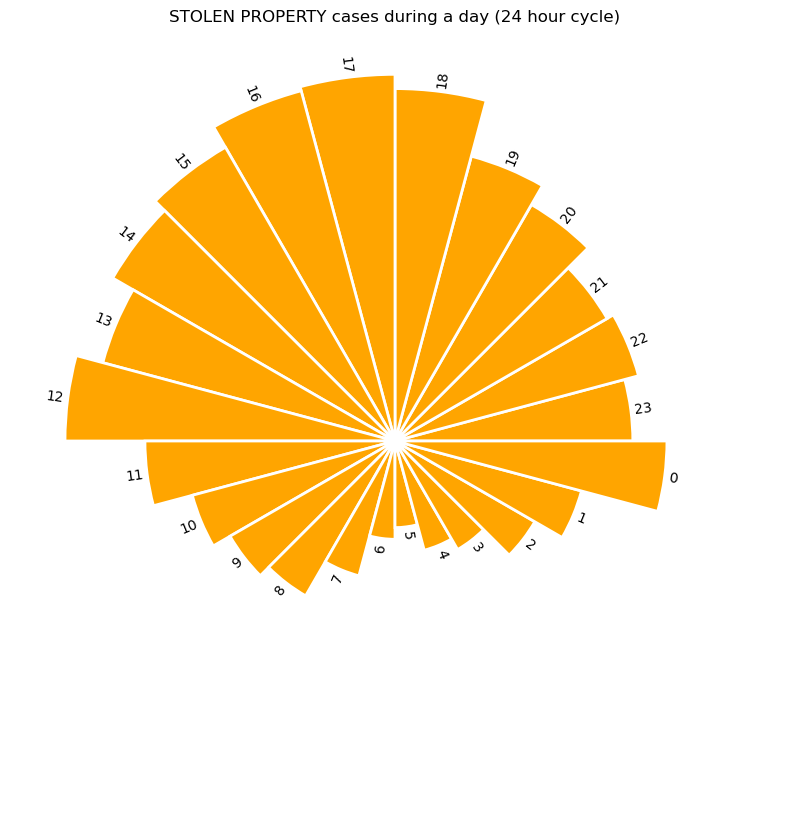

In [14]:
category = 'STOLEN PROPERTY'

# Calculate number of stolen property cases, grouped by hours
stolen_property_df = filtered_df[filtered_df['Category'] == category]
stolen_property_df.loc[:,'Hour'] = pd.to_datetime(stolen_property_df['Time']).dt.hour
hourly_counts = stolen_property_df['Hour'].value_counts().sort_index()

# Reverse hourly count to make the polar bar chart easier to read
reversed_hourly_counts = hourly_counts[::-1]

# Plot polar bar chart
create_polar_bar_chart(reversed_hourly_counts, category)

**Description**: The polar bar chart tells us about when stolen property cases happen during the day. It's interesting because there are fewer cases in the early morning, like between midnight to 12 AM. In general, from 5 AM to 5 PM, the number of cases slowly goes up, and then it starts going down again slowly. One reason for this could be that more people are out and about during the daytime, so there are more chances for thefts.

### * Short reflection on LLM usage (max 400 words)

Throughout the assignments, we relied on LLMs to optimize code, overcome challenges, and gain a deeper understanding of other types of plots.

Firstly, the LLM helped to condense code snippets, making them more concise and understandable and therefore improve readability and efficiency. We also asked for explanations for the optimized code to ensure comprehension.

Whenever we encountered obstacles, such as working with dates and times or ordering the data correctly, the LLM  helped to overcome these hurdles and let us proceed with the assignment.

Moreover, the LLM played a pivotal role in grasping and implementing other types of plots like the calendar plot and polar bar plot. By referring to examples from the package's documentation, we gained insights into the functionalities of the package and learned how to apply them effectively in our context. To give an example, we used a LLM to create the calendar plot. By specifying the expected data format (Pandas Series object with a DatetimeIndex as its index) based on the package documentation, the LLM helped us by providing the needed data format, which speeded up the plotting process while also offering detailed explanations along the way.

## A1 Part 2: Dataviz questions 

> * What is the difference between data and metadata? How does that relate to the GPS tracks-example?
> * Sune says that the human eye is a great tool for data analysis. Do you agree? Explain why/why not.
     * Mention something that the human eye is very good at.
     * Can you think of something that is difficult for the human eye to process visually. Explain why your example is difficult.
> * Simpson's paradox is hard to explain. Come up with your own example - or find one on line.
> * In your own words, explain the difference between exploratory and explanatory data analysis

### * What is the difference between data and metadata? How does that relate to the GPS tracks-example?

Data can be understood as a set of raw facts that, when processed and cleaned, can hold a lot of information about the given subject. Metadata is information about the data itself, data about the data. For the gps
WHen looking at the gps-tracker example, we can identify the metadata div having information about the garmin-connect product, whereas the data itself is mainly the longitude and latitudes at a specific time. 

The most common metadata examples are:  // as referenced from https://atlan.com/data-vs-metadata/
- Title
- Description
- Tags or categories
- Date of creation
- Who created it
- Source or origin
- Count and description of variables or attributes (e.g. rows and columns count for a data table)


### * Sune says that the human eye is a great tool for data analysis. Do you agree? Explain why/why not.

The human eye is indeed a powerful tool for data analysis, when the data is prepared in a manner that benefits the visual encoding. If the data is not presentable the eye can't really establish a differentiation between the features in the data, that might have a significant value. This comes to show easily if the data is purely presented in a "messy" fashion. This is why data visualization in itself is important, to ease the beholder's understanding using just their eyes. 

The eye is really fast at observing trends, but can then just as easily be tricked into seeing trends, where there perhaps are none.



### * Simpson's paradox is hard to explain. Come up with your own example - or find one on line.
One example I find easy to understand is the baseball-batter example. A player on 1 team can have a higher batting-average every year over several years, than another player, yet when looking at the total stats over those years, the second player can have an overall higher batting-average. This again just stems from the imbalance of the distribution of "balls played" during those years, which can then lead to the simpsons paradox.

https://towardsdatascience.com/simpsons-paradox-d2f4d8f08d42

### * In your own words, explain the differnece between exploratory and explanatory data analysis.

Even tough it is not entirely the same concept, I compare exploratory and explanatory data analysis to the concept of data "exploration vs exploitation", which is used in eg. reinforcement learning. Here it is a tradeoff of when you wish to continue exploring more about a given enviroment / dataset, or if you wish to dwelve more into and make the most of the data you currently have. Exploratory data analysis is a way of saying that you have a certain topic of interest, that you wish to uncover main aspects of a new problem, whereas explanatory data analysis aims to make you able to explain the core consequences and causes for a well-defined problem.

## A1 Part 3

> * Create a **choropleth map** of San Francisco that visualizes where it is safest to leave your car on a Sunday 
> * Questions to answer: 
    * Based on your map and analysis, where should you park the car for it to be safest on a Sunday? And where's the worst place?
    * Using visualizatios can help us uncover powerful data-patterns. However, when designing visualizations, we need to be aware of several illusions that can lead viewers to misinterpret the data we are showing (i.e. perceptual errors): 
        * Try to change the range of data-values in the plot above. Is there a way to make the difference between district less evident? 
        * Why do you think perceptual errors are a problem? Try to think of a few examples. 


### Choropleth map

In [15]:
def create_choropleth_map(data, color, range_max):
    # Fetch San Francisco Police District shapefiles in GeoJSON format
    with urlopen('https://raw.githubusercontent.com/suneman/socialdata2022/main/files/sfpd.geojson') as response:
        districts = json.load(response)

    # Create a choropleth map
    fig = px.choropleth_mapbox(data, 
                               geojson=districts, 
                               locations='PdDistrict', 
                               color=color,
                               color_continuous_scale="Plasma",
                               range_color=(0, range_max),  # Adjusted data range
                               mapbox_style="carto-positron",
                               zoom=11,  # Adjusted zoom level
                               center = {"lat": 37.7749, "lon": -122.4194},  # Centered on San Francisco
                               opacity=0.5,
                               labels={'Count':'Vehicle Theft Count'}
                              )

    fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
    fig.show()

In [16]:
category = 'VEHICLE THEFT'
weekday = 'Sunday'

# Filter dataset by weekday and crime category
filtered_df = df[(df['DayOfWeek'] == weekday) & (df['Category'] == category)]

# Aggregate data by police district
district_counts = filtered_df.groupby('PdDistrict').size().reset_index(name='Count')

# Create map
create_choropleth_map(district_counts, 'Count', district_counts['Count'].max())

### * Where should you park the car for it to be safest on a Sunday? And where's the worst place?
* It is safest to park the car in Tenderloin on a Sunday as the vehicle theft count is the lowest with 356 cases
* The worst place to par your car on a Sunday is Ingleside with a vehicle theft count of 2846 

### * Try to change the range of data-values in the plot above. Is there a way to make the difference between district less evident? 

Ideas to make less noticeable differences between the districts in the plot:
* We can normalize the count of vehicle theft incidents. This involves dividing the count for each district on Sunday by the total count of vehicle theft incidents on Sundays. By doing so, the counts of vehicle theft incidents for each district become relative to the total number of vehicle theft incidents on that day. This normalization ensures that the values are relative and comparable across all districts.

In [17]:
# Filter dataset by weekday and crime category
filtered_df = df[(df['DayOfWeek'] == weekday) & (df['Category'] == category)]

# Get total count of vehicle theft incidents
total_vehicle_theft_sundays = filtered_df['PdDistrict'].value_counts().sum()

# Normalize the count of vehicle theft incidents in each district
district_counts['NormalizedCount'] = district_counts['Count'] / total_vehicle_theft_sundays

create_choropleth_map(district_counts, 'NormalizedCount', 1)

### * Why do you think perceptual errors are a problem? Try to think of a few examples.

Perceptual errors occur when individuals misinterpret or misunderstand visual representations of information, due to factors such as misleading visual cues or inadequate labeling and scaling. These errors can lead to false conclusions, flawed decision-making, and/or a misunderstanding of the underlying data.

* In media, accurate data visualization is probably most important as media has a great influence over the public opinion, and misinformation can distort public perceptions of important issues.

* Accurate data visualization is particularly important when it comes to political issues such as elections, wars etc. Misleading information about candidates, elections, government policies or war crimes can potentially influence electoral outcomes and/or public discourse. 

* Easy to misinterpret/misleading information visualisation related to health, science, or public safety can have serious consequences, such as vaccine hesitancy during public health crises. 

## A1 Part 4: Errors in the data

> * In each of the 3 examples we listed during Week 4, describe in your own words how the data-errors I call attention to above can bias the binned versions of the data.
> * Also, briefly mention how not noticing these errors can result in misconceptions about the underlying patterns of what's going on in San Francisco (and our modeling).
> * Find your own example of human noise in the data and visualize it.
> * Did you find LLMs useful for anything in this exercise? Explain why/why not.

##### Mentioning the 3 examples here for continuity:
1. In the temporal activity for `PROSTITUTION` something surprising is going on on Thursday. Remind yourself [**here**](https://raw.githubusercontent.com/suneman/socialdata2022/main/files/prostitution.png), where I've highlighted the phenomenon I'm talking about.
2. Last week, when we investigated the details of how the timestamps are recorded using jitter-plots in the DAOST exercises, we saw that many more crimes were recorded e.g. on the hour, 15 minutes past the hour, and to a lesser in whole increments of 10 minutes. Crimes didn't appear to be recorded as frequently in between those round numbers. Remind yourself [**here**](https://raw.githubusercontent.com/suneman/socialdata2022/main/files/jitter.png), where I've highlighted the phenomenon I'm talking about.
3. Also, the *Hall of Justice* on the 800 block of Bryant street seems to be an unlikely hotspot for sex offences. Take a look here [**here**](https://raw.githubusercontent.com/suneman/socialdata2022/main/files/crime_hot_spot.png).

### * In each of the 3 examples we listed during Week 4, describe in your own words how the data-errors I call attention to above can bias the binned versions of the data. 

One thing is identifying and realizing that your data might have errors, and the next step is then to start thinking about the causation for said data-errors, as to prevent it, or to better understand how to circumvent them in the data-prepocessing, or ones might actually discover underlying structures in the data, that one had not thought off to begin with.

1. Data Errors Impact: Errors in recording or reporting prostitution incidents, such as misclassification or inaccuracies in timestamps, can skew the temporal analysis. The causation for this data error can be hard to pin-point, but truly highlights a problem that would have otherwise gone unnoticed, had one not visualized it in such a manner.

2. Data Errors Impact: Biases in timestamp recording, like higher frequency at specific intervals, can distort temporal distributions. This can be said to stem from police officers noting down the approximate time for the incident.

3. Data Errors Impact: Errors in location data, such as mislabeling or geocoding inaccuracies, can misrepresent hotspot areas. The causation here can be due to inaccuracies in the adresses, or a general miss-labeling.

### * Also, briefly mention how not noticing these errors can result in misconceptions about the underlying patterns of what's going on in San Francisco (and our modeling).

1. Misconceptions: Overlooking errors could lead to false conclusions about prostitution patterns, affecting resource allocation.
2. Misconceptions: Failing to address biases could lead to inaccurate conclusions about crime timing and resource allocation. This data-error also will impact a model heavily, as it indeed does display a trend in the data, more than a potential outlier.
3. Misconceptions: Ignoring location errors could lead to false assumptions about crime hotspots, impacting law enforcement strategies.


### * Find your own example of human noise in the data and visualize it.
In this exercise we are highlighting some potential errors, yet it should be stated that due to the lack of domain knowledge, it can be hard to identify an actual error rather than a potential trend or an intended behaviour. The first two cells presents burglary data as a heatmap, next to the police stations in SF. Chosen here is only the Burglary category, yet the behaviour of felonies in close proximity to the police stations is a recurring theme across the categories. 

In [18]:
# Data of the police stations in san francisco: 
# https://data.sfgov.org/Public-Safety/Police-Stations-2011-/rwdu-9wb2/data?no_mobile=true

data = {
    'District Name': ['CENTRAL STN', 'PARK STN', 'SOUTHERN STN', 'RICHMOND STN',"TENDERLOIN STN", 'BAYVIEW STN', 'INGLESIDE STN', 'MISSION STN', 'TARAVAL STN', 'NORTHERN STN'],
    'X': [37.798645, 37.767849	, 37.774989	, 37.780001, 37.783704, 37.729642, 37.724770, 37.762681, 37.743734, 37.780161	],
    'Y': [-122.409863, -122.455267, -122.404328,-122.464461, -122.412896,-122.398087,-122.446251, -122.421970,-122.481461, -122.432390]
}
stations_df = pd.DataFrame(data)


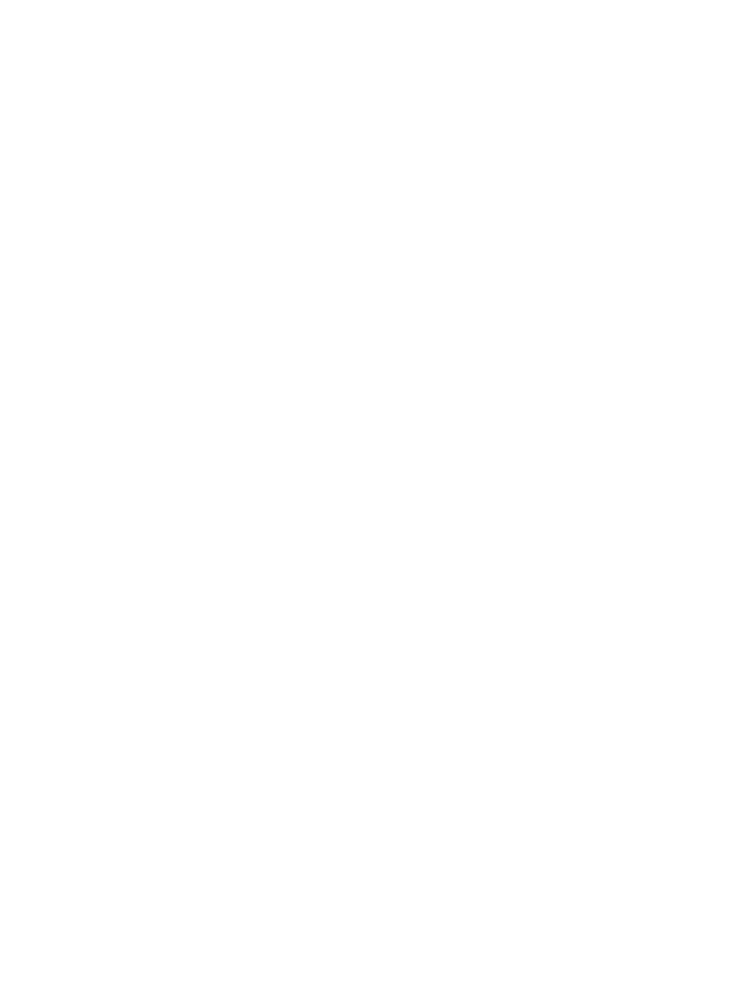

In [19]:
maps = []

for index, row in stations_df.iterrows():
    m = folium.Map(location=[row['X'], row['Y']], zoom_start=30)
    folium.Marker([row["X"], row["Y"]], popup=row["District Name"]).add_to(m)
    
    BURGLARY_data = focuscrimes_df[focuscrimes_df['Category'] == 'BURGLARY']
    
    BURGLARY_data['Date'] = pd.to_datetime(BURGLARY_data['Date'], format='%m/%d/%Y')

    BURGLARY_data['X'] = BURGLARY_data['X'].astype(float)
    BURGLARY_data['Y'] = BURGLARY_data['Y'].astype(float)
    BURGLARY_data = BURGLARY_data[['X', 'Y']]
    BURGLARY_data = BURGLARY_data.dropna(axis=0, subset=['X','Y'])
    BURGLARY_list = [[row['Y'],row['X']] for index, row in BURGLARY_data.iterrows()]
    HeatMap(BURGLARY_list, radius=25, blur = 15).add_to(m)
    maps.append(m._repr_html_())  

num_maps = len(maps)
num_cols = 3 
num_rows = (num_maps + num_cols - 1) // num_cols

fig, axes = plt.subplots(num_rows, num_cols, figsize=(15, num_rows * 5))

for i, map_html in enumerate(maps):
    ax = axes[i // num_cols, i % num_cols]  
    ax.axis('off')
    display(HTML(map_html)) 

for i in range(num_maps, num_rows * num_cols):
    axes[i // num_cols, i % num_cols].axis('off')

plt.tight_layout()
plt.show()


Other trends noticed in this group, is a discrepancy between the incident codes in the data, and the descriptions. There are instances, where a given description can have multiple incident codes. This is not a common occurence, which speaks to a human error. However, more domain knowledge would be needed to directly classify it as such. This observation is based on the following small showcase, showing exactly that this is a limited trend.

In [20]:
grouped = focuscrimes_df.groupby('Descript')['Incident Code'].nunique()
errors = grouped[grouped > 1]

if len(errors) == 0:
    print("There are no errors. Each description is linked to a unique incident code.")
else:
    print("Errors found:")
    print(errors)

Errors found:
Descript
GRAND THEFT BY PROSTITUTE            4
GRAND THEFT FROM PERSON              4
GRAND THEFT PICKPOCKET               4
GRAND THEFT PURSESNATCH              4
PETTY THEFT AUTO STRIP               3
PETTY THEFT BICYCLE                  3
PETTY THEFT COIN OPERATED MACHINE    3
PETTY THEFT FROM A BUILDING          3
PETTY THEFT FROM LOCKED AUTO         3
PETTY THEFT FROM UNLOCKED AUTO       3
PETTY THEFT MOTORCYCLE STRIP         3
PETTY THEFT OF PROPERTY              3
PETTY THEFT PHONE BOOTH              3
PETTY THEFT SHOPLIFTING              3
ROBBERY,  ATM, FORCE, ATT.           2
THEFT, BOAT                          2
Name: Incident Code, dtype: int64


### * Did you find LLMs useful for anything in this exercise? Explain why/why not.
A large language model can be tricky to utilize in an exercise like this, where the main goal is to do personal reflections on the observed errors and trends. Especially for tasks where the dilemmas are using data as well as pictures that are outside the reach of the LLM's database. We used an LLM to uncover more typical data-errors and their causations, as to better have an idea of the scope of the personal reflections. 

# Contributions

**This section states which team members contributed with what during the development of this assignment.** 

**All team members have understodd all aspects of the assignment, and the percentages here try to reflect at most, from whose individual notebooks, the majority of the code is utilized.**

s223080 Sari Guci **//** A1: 70%, A2:30%, A3:70%, A4:30%

s174061 Anders Larsen **//** A1: 30%, A2: 70%, A3: 30%, A4: 70%